In [1]:
import cellshape_helper as helper

path = "/home/mvries/Documents/modelnet/"

PATH_TO_TIF_FILES = (
    path + "stacked/"
)
PATH_TO_SAVE_MESH = path + "stacked_off/"
PATH_TO_SAVE_PC = path + "stacked_pointcloud/"
NUM_POINTS = 2048

helper.mesh_to_pc(
     PATH_TO_SAVE_MESH, NUM_POINTS, PATH_TO_SAVE_PC
)

100%|██████████| 1/1 [00:00<00:00, 77.96it/s]


In [2]:
from pyntcloud import PyntCloud

image = PyntCloud.from_file(PATH_TO_SAVE_PC + "chair_0001.ply")

In [5]:
import numpy as np

image = image.points.values

In [7]:
from sklearn.neighbors import kneighbors_graph
import pandas as pd
import numpy as np

A = kneighbors_graph(image, 40, mode='connectivity', include_self=False)
A.toarray()

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [8]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import networkx as nx


# Use seed when creating the graph for reproducibility
G = nx.Graph(A)
# position is stored as node attribute data for random_geometric_graph
pos = nx.get_node_attributes(G, "pos")


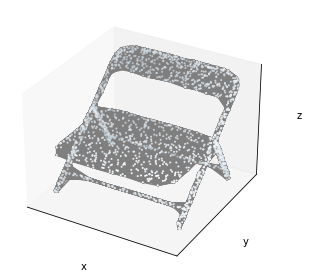

In [11]:
# 3d spring layout
pos = image
# Extract node and edge positions from the layout
node_xyz = np.array([pos[v] for v in sorted(G)])
edge_xyz = np.array([(pos[u], pos[v]) for u, v in G.edges()])


# Create the 3D figure
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")

# Plot the nodes - alpha is scaled by "depth" automatically
ax.scatter(*node_xyz.T, s=1, ec="w")

# Plot the edges
for vizedge in edge_xyz:
    ax.plot(*vizedge.T, color="tab:gray")


def _format_axes(ax):
    """Visualization options for the 3D axes."""
    # Turn gridlines off
    ax.grid(False)
    # Suppress tick labels
    for dim in (ax.xaxis, ax.yaxis, ax.zaxis):
        dim.set_ticks([])
    # Set axes labels
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.set_zlabel("z")


_format_axes(ax)
fig.tight_layout()
plt.show()

In [12]:
Xe = np.zeros(edge_xyz[:,:,0].flatten().T.shape[0] + ((edge_xyz[:,:,0].flatten().T.shape[0])//2))
for i in range(1, Xe.shape[0]+1):
    if i % 3 == 0:
        Xe[i-1] = Nonez
    else:
        Xe[i-1] = edge_xyz[:,:,0].flatten().T[i + (i // 3)*(-1)-1]

In [13]:
Ye = np.zeros(edge_xyz[:,:,1].flatten().T.shape[0] + ((edge_xyz[:,:,1].flatten().T.shape[0])//2))
for i in range(1, Ye.shape[0]+1):
    if i % 3 == 0:
        Ye[i-1] = None
    else:
        Ye[i-1] = edge_xyz[:,:,1].flatten().T[i + (i // 3)*(-1)-1]

In [14]:
Ze = np.zeros(edge_xyz[:,:,2].flatten().T.shape[0] + ((edge_xyz[:,:,2].flatten().T.shape[0])//2))
for i in range(1, Ze.shape[0]+1):
    if i % 3 == 0:
        Ze[i-1] = None
    else:
        Ze[i-1] = edge_xyz[:,:,2].flatten().T[i + (i // 3)*(-1)-1]

In [15]:
from chart_studio import plotly as py
import plotly.graph_objs as go

trace1=go.Scatter3d(x=Ze,
               y=-Xe,
               z=Ye,
               mode='lines',
               line=dict(color='rgb(125,125,125)', width=0.5),
               hoverinfo='none'
               )

trace2=go.Scatter3d(x=node_xyz[:,2],
               y=-node_xyz[:,0],
               z=node_xyz[:,1],
               mode='markers',
               name='actors',
               marker=dict(symbol='circle',
                             size=1,
                             colorscale='Viridis',
#                              line=dict(color='rgb(255,0,0)', width=0.5)
                             ),
               hoverinfo='text'
               )

axis=dict(showbackground=True,
          showline=False,
          zeroline=False,
          showgrid=True,
          showticklabels=True,
          title=''
          )

layout = go.Layout(
#          title="Network of coappearances of characters in Victor Hugo's novel<br> Les Miserables (3D visualization)",
         width=1000,
         height=1000,
         showlegend=False,
         scene=dict(
             xaxis=dict(axis),
             yaxis=dict(axis),
             zaxis=dict(axis),
        ),
     margin=dict(
        t=100
    ),
    hovermode='closest',
    annotations=[
           dict(
           showarrow=True,
            x=0,
            y=0.1,
            xanchor='left',
            yanchor='bottom',
            font=dict(
            size=14
            )
            )
        ],    )


In [16]:
from plotly.offline import iplot
data=[trace1, trace2]
fig=go.Figure(data=data, layout=layout)
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=-1, y=-1, z=-1)
)
fig.update_layout(autosize=False,
#                   scene_camera=camera,
                                    scene_camera_eye=dict(x=1.25, y=2.25, z=.2),

                  width=800, height=800,
#                   margin=dict(l=85, r=180, b=65, t=90)
                 )

iplot(fig, filename='Les-Miserables')
import os


# fig.write_image(figures_path + "pointcloud_crazy_recon.png", scale=3)
fig.write_image(figures_path + "render.png", scale=3)

NameError: name 'figures_path' is not defined

In [17]:
import trimesh

path = "/home/mvries/Documents/Datasets/OPM/SingleCellFromNathan_17122021/Plate3/stacked_off/raw/Cells/0141_0009_accelerator_20210318_bakal03_erk_main_21-03-18_17-38-12.off"
mesh = trimesh.load(path)


In [18]:
mesh

<trimesh.Trimesh(vertices.shape=(23855, 3), faces.shape=(47710, 3))>

In [19]:
smoothed = trimesh.smoothing.filter_laplacian(mesh)

In [20]:
smoothed.export("/home/mvries/Desktop/" + "smoothed.off")

'OFF\n23855 47710 0\n1.8399491993 26.8859159562 5.4605524849\n2.0364350463 27.0074756986 5.3851020476\n2.0999053243 26.7192280570 5.4894748316\n1.9489988841 26.8289502256 5.6429154115\n1.8672185310 27.0245582600 5.5499063506\n2.4937089502 26.7794792405 5.2978661416\n2.5333956674 26.4627753705 5.5178715376\n2.4956772256 26.5122149330 5.9779589532\n2.1211432812 27.0829532059 5.9069845576\n2.5173470412 26.9422462315 6.3868966704\n2.0983389014 27.2950755219 5.5837125494\n2.5936364879 27.3282830963 5.3563219750\n2.2474158272 27.5078113695 5.9133768987\n2.4806100895 27.4413816633 6.3539071766\n2.4307627514 27.6505853693 5.6845109338\n2.6294790961 27.8748346632 6.1192265019\n2.9580265013 26.1673063451 5.7538621234\n3.0670940835 26.4078460167 5.3764665258\n3.6451897231 26.0571108639 5.6914841154\n3.4256018450 25.9536145861 6.1219360859\n2.9515896409 26.1113585492 6.0672419348\n3.1575337029 26.1510277034 6.4201029226\n3.1871897332 26.9020539126 5.1853855678\n2.9721500926 26.5804077381 6.6673399

In [ ]:
0047_0092_accelerator_20210318_bakal03_erk_main_21-03-18_17-38-12.off